# Cool things with SunPy's Ecosystem

This notebook is just a collection of what the author(s) considers cool. 
Your opinion might be different.

*Parts of this notebook have been directly adapted from [this notebook](https://github.com/sunpy/aas-2021-workshop/blob/main/02-Introduction-to-Coordinates.ipynb) presented by Dr. Albert Y. Shih at the 2021 AAS SPD SunPy Workshop and from [this notebook](https://github.com/heliophysicsPy/summer-school-24/blob/main/sunpy-tutorial/sunpy-pyspedas-showcase/sunpy-pyspedas-demo.ipynb) presented by Dr. Will "Flyboy" Barnes at the 2024 PyHC Summerschool)*

**This requires some of the data files from the main tutorial, so you will need to at least run those cells first.**

In [115]:
import pathlib
from IPython.display import HTML
import matplotlib.pyplot as plt
import numpy as np
import astropy.units as u

import numpy as np
import matplotlib.pyplot as plt

import astropy.units as u
import astropy.time
from astropy.wcs import WCS

import sunpy.map
import sunpy.timeseries
import sunpy.sun

from matplotlib.colors import SymLogNorm
from astropy.visualization import time_support, ImageNormalize, quantity_support, AsinhStretch, PowerStretch

import sunpy
sunpy.log.setLevel('ERROR')

DATA_DIR = pathlib.Path('./')

### Combining Data from AIA, EUI, and EUVI

Finally, let's combine the data from all three of these observatories into a single image by *reprojecting* them into a common coordinate system.
The approach we will follow here is adapted from [this example](https://docs.sunpy.org/en/stable/generated/gallery/map_transformations/reprojection_aia_euvi_mosaic.html#sphx-glr-generated-gallery-map-transformations-reprojection-aia-euvi-mosaic-py) from our gallery in the `sunpy` documentation.

In [2]:
aia_files = sorted((DATA_DIR / 'data/AIA/').glob('*.fits'))
stereo_files = sorted((DATA_DIR / 'data/SECCHI/').glob('*.fts'))
m_aia = sunpy.map.Map(aia_files[6])
m_stereo = sunpy.map.Map(stereo_files[6])

#### Preparing the Image Data

When combining these images all three need to assume the same radius of
the Sun for the data. The AIA images specify a slightly different value
than the IAU 2015 constant. To avoid coordinate transformation issues we
reset this here.



In [3]:
m_stereo.meta['rsun_ref'] = sunpy.sun.constants.radius.to_value(u.m)
m_aia.meta['rsun_ref'] = sunpy.sun.constants.radius.to_value(u.m)

Before combining all of our images, we need to make a few adjustments to some of the maps.

Neither the AIA nor the EUVI map have been normalized to the exposure time so we do that here such that all images have the same units.

In [4]:
m_aia /= m_aia.exposure_time
m_stereo /= m_stereo.exposure_time

Additionally, the 304 channel of AIA has experienced significant degradation since the launch of the satellite in 2010.
The SunPy affiliated package `aiapy` includes a model of this degradation as a function of time.
To illustrate this, we can plot the degradation of the 304 channel (and 171 channel for reference) as a function of time.

In [5]:
time_0 = astropy.time.Time('2010-03-25T00:00:00', scale='utc')
now = astropy.time.Time.now()
time = time_0 + np.arange(0, (now - time_0).to(u.day).value, 7) * u.day

In [6]:
from aiapy.calibrate import degradation
from aiapy.calibrate.util import get_correction_table

table = get_correction_table("JSOC")
deg_171 = degradation(171*u.angstrom, time, correction_table=table)
deg_304 = degradation(304*u.angstrom, time, correction_table=table)

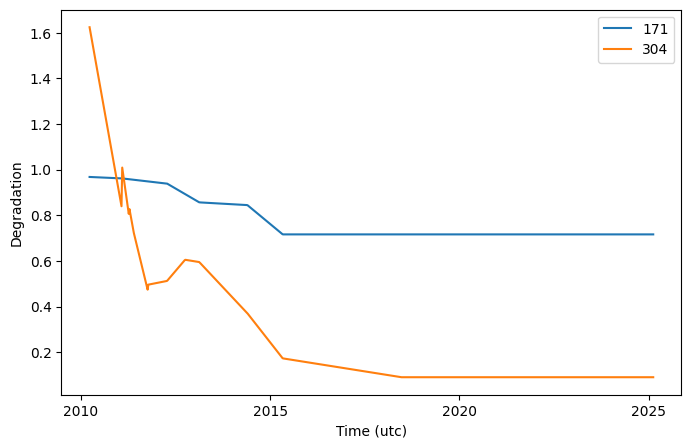

In [7]:
plt.figure(figsize=(8,5))
with time_support(format='jyear'):
    plt.plot(time, deg_171, label='171')
    plt.plot(time, deg_304, label='304')
plt.ylabel('Degradation')
plt.legend()

In order to bring the AIA 304 channel up to comparable intensity levels, we must correct for this degradation.
Fortunately, `aiapy` provides a convenient function for applying this correction.

In [8]:
from aiapy.calibrate import correct_degradation

In [9]:
m_aia_corrected = correct_degradation(m_aia, correction_table=table)

#### Reproject and Coadd

The next step is to calculate the output coordinate system for the combined
map. We select a heliographic Stonyhurst frame, and a Plate Carree (CAR)
projection, and generate a header using `sunpy.map.make_fitswcs_header` and
then construct a World Coordinate System (WCS) object for that header.



In [10]:
from astropy.coordinates import SkyCoord

shape_out = (360, 720)  # This is set deliberately low to reduce memory consumption
header = sunpy.map.make_fitswcs_header(shape_out,
                                       SkyCoord(0, 0, unit=u.deg,
                                                frame="heliographic_stonyhurst",
                                                obstime=m_aia_corrected.date),
                                       scale=[360 / shape_out[1], 180 / shape_out[0]] * u.deg / u.pix,
                                       wavelength=int(m_aia_corrected.meta['wavelnth']) * u.AA,
                                       projection_code="CAR")
out_wcs = WCS(header)

Next we call the `reproject.mosaicking.reproject_and_coadd` function, which
takes a list of maps, and the desired output WCS and array shape.



In [11]:
from reproject import reproject_interp
from reproject.mosaicking import reproject_and_coadd

array, footprint = reproject_and_coadd([m_aia_corrected, m_stereo], out_wcs, shape_out,
                                       reproject_function=reproject_interp)

2025-02-18 14:14:57 - reproject.mosaicking.coadd - INFO: Output mosaic will have shape (360, 720)
2025-02-18 14:14:57 - reproject.mosaicking.coadd - INFO: Using on-the-fly mode for adding individual reprojected images to output array
2025-02-18 14:14:57 - reproject.mosaicking.coadd - INFO: Processing input data 1 of 2
2025-02-18 14:14:57 - reproject.mosaicking.coadd - INFO: Calling reproject_interp with shape_out=(360, 720)
2025-02-18 14:14:57 - reproject.common - INFO: Calling _reproject_full in non-dask mode
2025-02-18 14:14:57 - reproject.mosaicking.coadd - INFO: Adding reprojected array to final array
2025-02-18 14:14:57 - reproject.mosaicking.coadd - INFO: Processing input data 2 of 2
2025-02-18 14:14:57 - reproject.mosaicking.coadd - INFO: Calling reproject_interp with shape_out=(360, 720)
2025-02-18 14:14:57 - reproject.common - INFO: Calling _reproject_full in non-dask mode
2025-02-18 14:14:57 - reproject.mosaicking.coadd - INFO: Adding reprojected array to final array
2025-02-

To display the output we construct a new map using the new array and our generated header.

In [12]:
outmap = sunpy.map.Map(array, header)

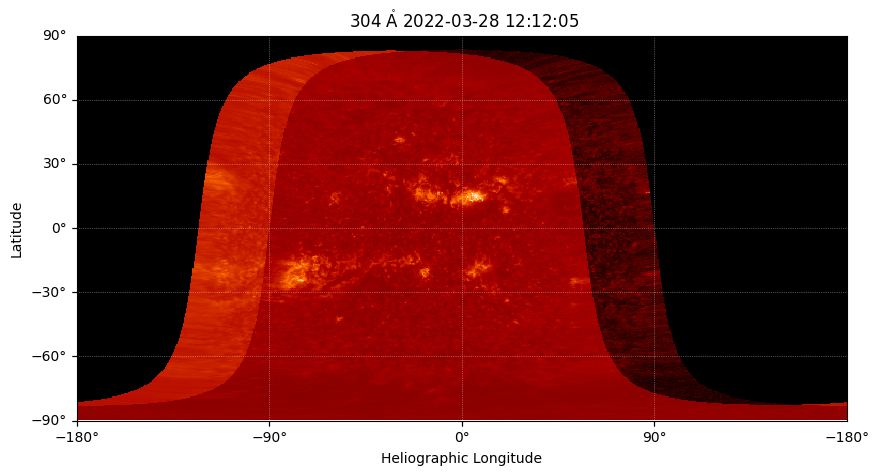

In [13]:
plt.figure(figsize=(10,5))
outmap.plot(cmap='sdoaia304', norm=m_aia.plot_settings['norm'])

#### Coordinate Dependent Weighting

As you can see this leaves a little to be desired. To reduce the obvious warping towards the points which are close to the limb in the input images, we can define a set of weights to use when co-adding the output arrays.
To reduce this warping we want to calculate an set of weights which highly weight points close to the center of the disk in the input image.

We can achieve this by using sunpy's coordinate framework. First we calculate all the world coordinates for all the pixels in all three input maps.

In [14]:
maps = [m_aia_corrected, m_stereo]

In [15]:
coordinates = tuple(map(sunpy.map.all_coordinates_from_map, maps))

To get a weighting which is high close to disk centre and low towards
the limb, we can use the Z coordinate in the heliocentric frame. This
coordinate is the distance of the sphere from the centre of the Sun
towards the observer.



In [16]:
weights = [coord.transform_to("heliocentric").z.value for coord in coordinates]

These weights are good, but they are better if the ramp down is a little
smoother, and more biased to the centre. Also we can scale them to the
range 0-1, and set any off disk (NaN) regions to 0.



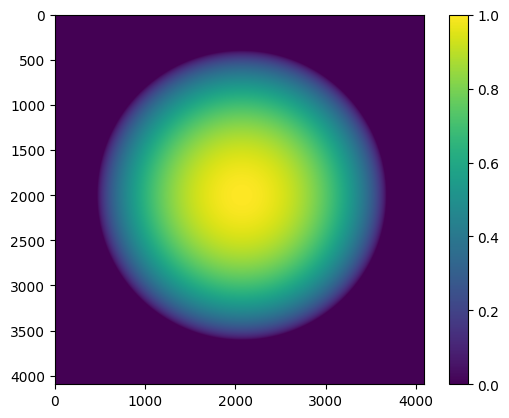

In [17]:
weights = [(w / np.nanmax(w)) ** 1.5 for w in weights]
for w in weights:
    w[np.isnan(w)] = 0

plt.imshow(weights[0])
plt.colorbar()

Now we can rerun the reprojection. This time we also set
``match_background=True`` which scales the images by a single scaling
factor so they are of similar brightness. We also set
``background_reference=0`` which uses the AIA map as the reference for
the background scaling.

In [18]:
array, _ = reproject_and_coadd(maps, out_wcs, shape_out,
                               input_weights=weights,
                               reproject_function=reproject_interp,
                               match_background=True,
                               background_reference=0)

2025-02-18 14:15:02 - reproject.mosaicking.coadd - INFO: Output mosaic will have shape (360, 720)
2025-02-18 14:15:02 - reproject.mosaicking.coadd - INFO: Not using on-the-fly mode for adding individual reprojected images to output array
2025-02-18 14:15:02 - reproject.mosaicking.coadd - INFO: Processing input data 1 of 2
2025-02-18 14:15:02 - reproject.mosaicking.coadd - INFO: Calling reproject_interp with shape_out=(360, 720)
2025-02-18 14:15:02 - reproject.common - INFO: Calling _reproject_full in non-dask mode
2025-02-18 14:15:02 - reproject.mosaicking.coadd - INFO: Calling reproject_interp with shape_out=(360, 720) for weights
2025-02-18 14:15:02 - reproject.common - INFO: Calling _reproject_full in non-dask mode
2025-02-18 14:15:02 - reproject.mosaicking.coadd - INFO: Adding reprojected array to list to combine later
2025-02-18 14:15:02 - reproject.mosaicking.coadd - INFO: Processing input data 2 of 2
2025-02-18 14:15:02 - reproject.mosaicking.coadd - INFO: Calling reproject_inte

Once again we create a new map from our reprojected array and new header.

In [19]:
combined_map = sunpy.map.Map(array, header)

We can plot our corrected reprojected array, this time overlaying the limb as seen from the three different observatories.

If you had the location of the flare from the HEK, you can add that as well!

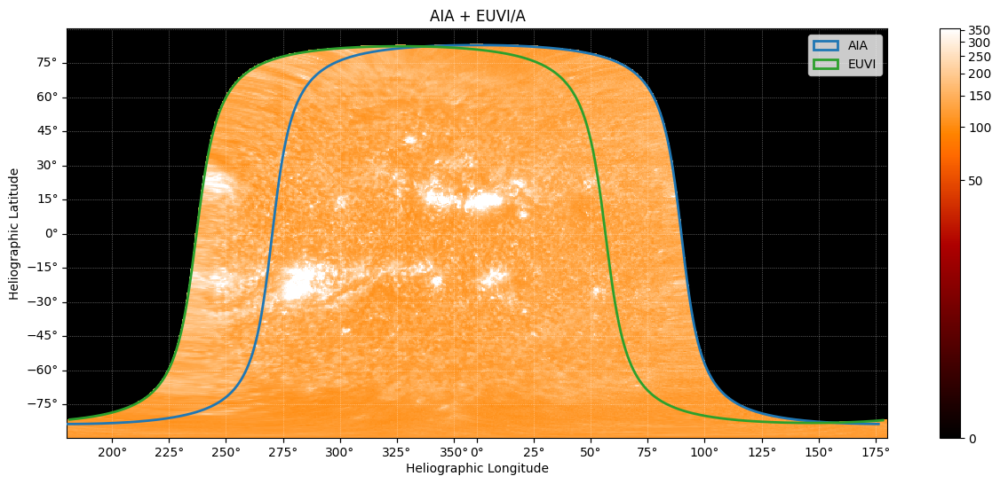

In [20]:
fig = plt.figure(figsize=(15, 6))
ax = fig.add_subplot(projection=combined_map)
im = combined_map.plot(axes=ax, cmap='sdoaia304', norm=m_aia.plot_settings['norm'],
                       clip_interval=(1,99.5)*u.percent,
                       title='AIA + EUVI/A')

# Fix the tick formatting
lon, lat = ax.coords
lon.set_coord_type("longitude")
lon.set_format_unit(u.deg)
lat.set_coord_type("latitude")
lat.set_format_unit(u.deg)

# Fix the labeling
lon.set_axislabel('Heliographic Longitude', minpad=0.8)
lat.set_axislabel('Heliographic Latitude', minpad=0.9)
lon.set_ticks(spacing=25*u.deg, color='k')
lat.set_ticks(spacing=15*u.deg, color='k')

# Reset the view to pixel centers
_ = ax.axis((0, shape_out[1], 0, shape_out[0]))

# Draw the limb as defined by each spacecraft
m_aia.draw_limb(axes=ax, color="C0", lw=2, label='AIA')
m_stereo.draw_limb(axes=ax, color="C2", lw=2, label='EUVI')

# Add the legend and colorbar
plt.legend()
plt.colorbar(im, ax=ax)

## When did the CME happen?

Using the arrival time of the event at Earth, we can get a rough estimate of when the event occured. Let's search for LASCO data during this interval to see if we can see the eruption of the CME. LASCO, or the Large Angle and Spectrometric Coronagraph Experiment, is a coronagraph instrument on the SOHO spacecraft.

To do this we'll use the `Fido` search interface we learned about on during the SunPy tutorial.
We'll designate the time interval of our search using the `Time` object provided by `astropy`.
Recall that we learned some basics about how to manipulate `Time` objects on Monday.
We'll continue to reuse this interval throughout this demonstration.

In [21]:
import astropy.time

In [22]:
time_event_start = astropy.time.Time('2023-03-20 13:00:00')
time_event_end = astropy.time.Time('2023-03-20 19:00:00')

In [23]:
from sunpy.net import Fido, attrs as a

In [24]:
q_lasco = Fido.search(a.Time(time_event_start, end=time_event_end),
                      a.Instrument.lasco,
                      a.Detector.c2)

The cadence of the LASCO data is relatively low so let's go ahead and download every LASCO C2 file in this interval.

In [25]:
files_lasco = Fido.fetch(q_lasco, path='data/{instrument}')

Files Downloaded:   0%|          | 0/38 [00:00<?, ?file/s]

We can then load every file into a `Map` and create a `MapSequence`. `MapSequence` objects are used for storing `Map`s at subsequent time steps and are useful primarily for visualizing our 2D observations as a function of time.

In [26]:
import sunpy.map

In [27]:
m_lasco = sunpy.map.Map(DATA_DIR / 'data/LASCO/', sequence=True)

Let's also divide out the exposure time of each frame so that this does not influence the amount of emission per frame.

In [28]:
m_lasco = sunpy.map.Map([m/m.exposure_time for m in m_lasco], sequence=True)

Visualizing one of the `Map` objects in our stack about halfway through our interval, we can see some very faint structures off of the limb.

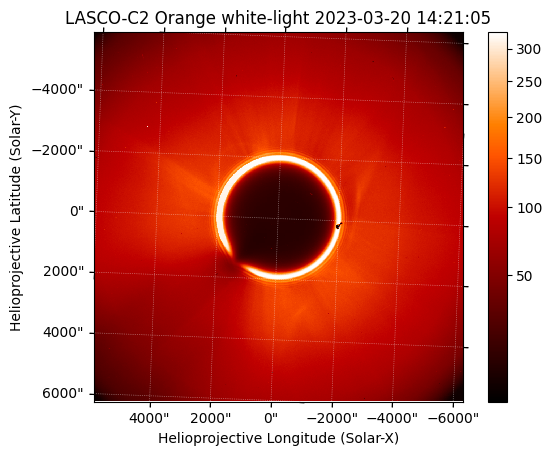

In [29]:
m_lasco[10].peek()

To bring out the structure of the CME, we can compute a running difference movie from our stack of images.

In [30]:
m_lasco_running = sunpy.map.Map([m - prev_m.quantity for m, prev_m in zip(m_lasco[1:], m_lasco[:-1])],
                                sequence=True)

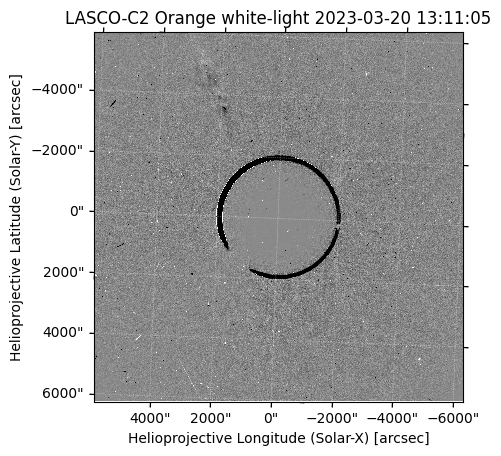

In [31]:
ani = m_lasco_running.plot(norm=ImageNormalize(vmin=-5,vmax=5), cmap='Greys_r')

In [32]:
HTML(ani.to_jshtml())

2025-02-18 14:15:12 - matplotlib.animation - INFO: Animation.save using <class 'matplotlib.animation.HTMLWriter'>


## When did the corresponding flare *actually* start?

We've now confirmed that the eruption occurred within the expected time interval. Our next question is when did this event kick off on the Sun?

To answer this, we can first search for data from the GOES XRS instrument. The GOES XRS instrument gives us the disk-integrated *soft x-ray* time series in two different energy channels. This provides an indication of when the flare started.

We can again use `Fido` and our selected time interval to search for and download GOES XRS data.

In [33]:
q_goes = Fido.search(a.Time(time_event_start, time_event_end),
                     a.Instrument.xrs,
                     a.goes.SatelliteNumber(18),
                     a.Resolution('flx1s'))

In [34]:
file_goes = Fido.fetch(q_goes, path='data/{instrument}/{file}')

Files Downloaded:   0%|          | 0/1 [00:00<?, ?file/s]

Now, that we've downloaded the necessary GOES XRS files, we can load them into a `TimeSeries` object and visualize the resulting lightcurve. Recall that we learned the basics of creating and visualizing a `TimeSeries` object on Monday.

In [35]:
import sunpy.timeseries

In [36]:
ts_goes = sunpy.timeseries.TimeSeries(DATA_DIR / 'data/XRS/', concatenate=True)

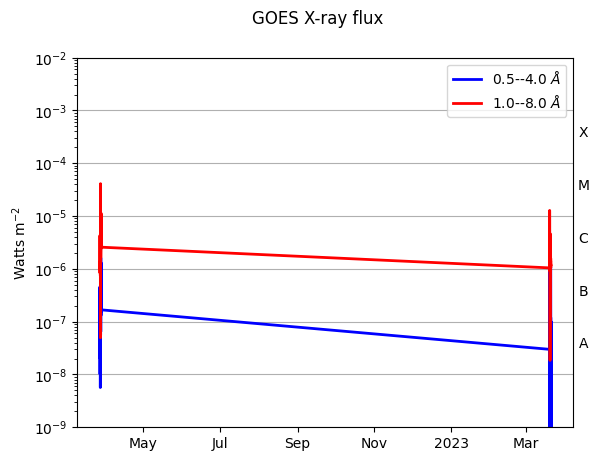

In [37]:
ts_goes.peek()

Because of the way GOES XRS data is packaged, our time series covers the whole day which clearly includes many other events. Let's use the `truncate` method to zoom in on our just the interval we are interested in.

In [38]:
from sunpy.time import TimeRange

In [39]:
ts_goes_flare = ts_goes.truncate(TimeRange(time_event_start, b=time_event_end))

Note that our resulting light curve for just the event of interest has a shape very characteristic of a medium-sized flare.

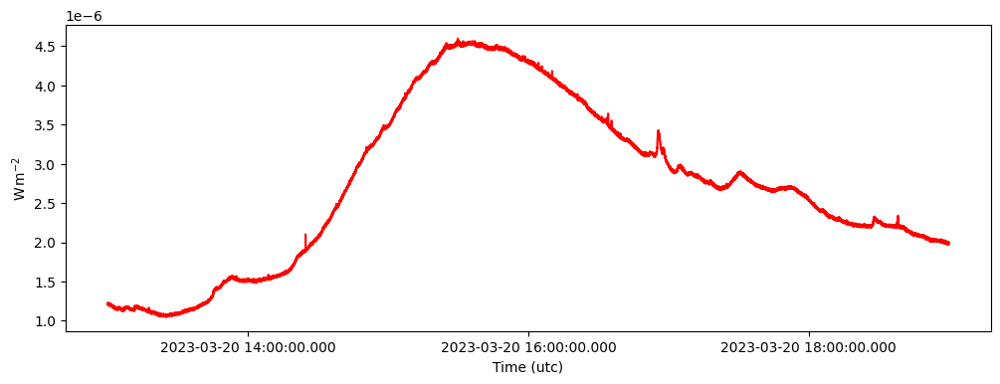

In [42]:
plt.figure(figsize=(12,4))
with quantity_support():
    with time_support(simplify=True):
        plt.plot(ts_goes_flare.time, ts_goes_flare.quantity('xrsb'), color='red')
plt.show()

Let's define the peak time of our event using the maximum of the emission in this lower energy channel of GOES XRS. We'll refer to this as the peak time of the flare.

In [43]:
time_peak = ts_goes_flare.time[ts_goes_flare.quantity('xrsb').argmax()]

In [44]:
time_peak

<Time object: scale='utc' format='iso' value=2023-03-20 15:29:52.561>

## Where did this event come from?

Now that we know when the flare started, we need to know from where on the solar disk it came. Our coronagraph images obscure the solar disk and the aforementioned XRS time series are integrated over the whole disk. Fortunately, we have a suite of EUV imaging instruments pointed at the Sun that can help us answer this question.

Let's first find out where several of these instruments were. `solarmach`, a SunPy-affiliated package, makes this easy to do.

In [45]:
import solarmach

In [46]:
spacecraft = [
    'SDO',
    'PSP',
    'Solar Orbiter',
    'SOHO'
]

In [47]:
smach = solarmach.SolarMACH(time_peak, spacecraft, vsw_list=[400]*len(spacecraft))

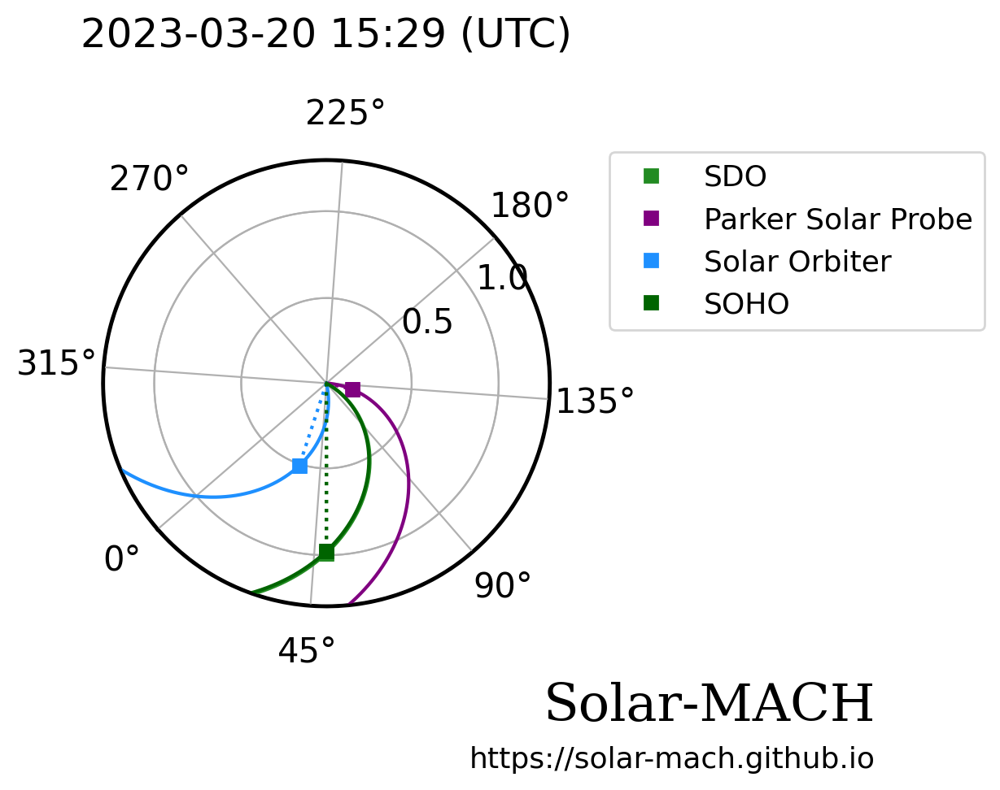

In [48]:
smach.plot(figsize=(6.5,6.5), plot_sun_body_line=True)

We can see that *Solar Orbiter* and SDO are in a favorable configuration to view the Sun from different vantage points, providing us a multi-perspective view of the solar disk around the time when the flare went off. Notice that *Solar Orbiter* is slightly off the Sun-Earth line, meaning it provides an additional constraint from different viewing angle on the flare and eruption.

Let's first look at the HXR and SXR flux as measured by the STIX instrument on *Solar Orbiter*. STIX data is not currently provided by any of the data providers that `Fido` searches by default. However, we can use the `stixpy` package to tell `Fido` to also search the STIX data center when looking for data.

In [49]:
from stixpy.net.client import STIXClient

In [50]:
q_stix = Fido.search(a.Time(time_event_start, time_event_end),
                     a.Instrument.stix,
                     a.stix.DataProduct.ql_lightcurve)

In [51]:
q_stix

Start Time,End Time,Instrument,Level,DataType,DataProduct,Ver,Request ID
Time,Time,str4,str2,str2,str13,str3,str1
2023-03-20 00:00:00.000,2023-03-20 23:59:59.999,STIX,L1,QL,ql-lightcurve,V02,-


In [52]:
file_stix = Fido.fetch(q_stix, path='data/{instrument}/{file}')

Files Downloaded:   0%|          | 0/1 [00:00<?, ?file/s]

After downloading our STIX data, we can then visualize these lightcurves in the exact same manner as we did with our XRS data. Again, we note that `sunpy` does not support STIX data by default, but by using `stixpy`, we can tell `TimeSeries` how to load this data and parse the accompanying metadata. 

In [53]:
from stixpy.timeseries import quicklook

In [54]:
ts_stix = sunpy.timeseries.TimeSeries(DATA_DIR / 'data/STIX', concatenate=True)

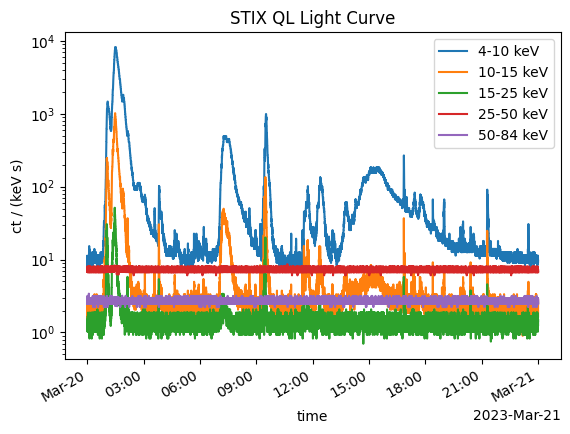

In [55]:
ts_stix.peek()

As before, let's truncate our lightcurve to the interval of interest.

In [56]:
ts_stix_flare = ts_stix.truncate(TimeRange(time_event_start, b=time_event_end))

We can overplot our STIX data on top of our GOES light

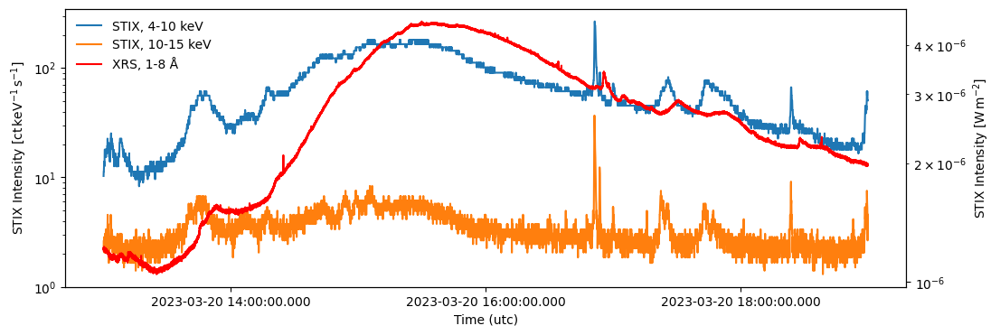

In [57]:
fig = plt.figure(figsize=(12,4))
ax_stix = fig.add_subplot()
ax_stix.set_ylabel(f'STIX Intensity [{ts_stix_flare.units["4-10 keV"]:latex_inline}]')
ax_goes = ax_stix.twinx()
ax_goes.set_ylabel(f'STIX Intensity [{ts_goes_flare.units["xrsb"]:latex_inline}]')
with time_support(simplify=True):
    l1, = ax_stix.plot(ts_stix_flare.time, ts_stix_flare.quantity('4-10 keV'), label='STIX, 4-10 keV')
    l2, = ax_stix.plot(ts_stix_flare.time, ts_stix_flare.quantity('10-15 keV'), color='C1', label='STIX, 10-15 keV')
    l3, = ax_goes.plot(ts_goes_flare.time, ts_goes_flare.quantity('xrsb'),color='red', label='XRS, 1-8 Å')
ax_stix.set_yscale('log')
ax_goes.set_yscale('log')
ax_stix.legend([l1,l2,l3], [l.get_label() for l in [l1,l2,l3]], loc=2, frameon=False)
plt.show()

Note that these curves do *appear* to be correlated, but there is a clear offset between the two of them. **Why is that?**

Recall from our spacecraft position plot above that *Solar Orbiter* is much closer to the Sun than the Earth (GOES is in a goestationary orbit). As such emission from the Sun arrives at *Solar Orbiter* sooner than it does at GOES XRS. We can easily approximate this light travel time correction using the two spacecraft positions.

In [58]:
from sunpy.coordinates import get_horizons_coord, get_earth

In [59]:
earth_loc = get_earth(time_event_start)
solo_loc = get_horizons_coord('SolO', time=time_event_start)

In [60]:
import astropy.constants as const

In [61]:
light_travel_time = ((earth_loc.radius - solo_loc.radius) / const.c).to('s')

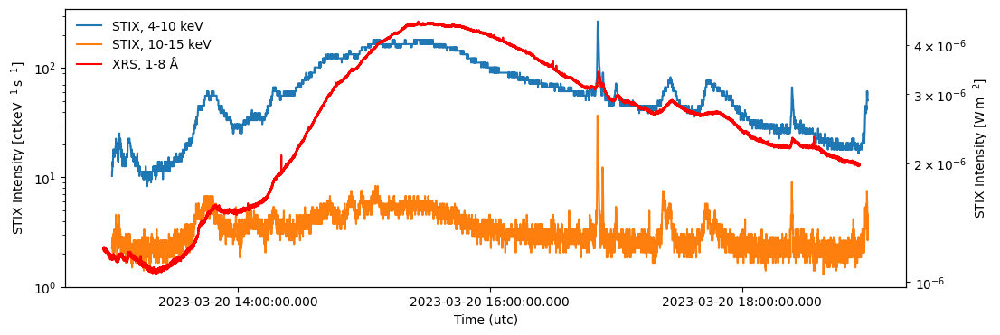

In [62]:
fig = plt.figure(figsize=(12,4))
ax_stix = fig.add_subplot()
ax_stix.set_ylabel(f'STIX Intensity [{ts_stix_flare.units["4-10 keV"]:latex_inline}]')
ax_goes = ax_stix.twinx()
ax_goes.set_ylabel(f'STIX Intensity [{ts_goes_flare.units["xrsb"]:latex_inline}]')
with time_support(simplify=True):
    l1, = ax_stix.plot(ts_stix_flare.time, ts_stix_flare.quantity('4-10 keV'), label='STIX, 4-10 keV')
    l2, = ax_stix.plot(ts_stix_flare.time, ts_stix_flare.quantity('10-15 keV'), color='C1', label='STIX, 10-15 keV')
    l3, = ax_goes.plot(ts_goes_flare.time-light_travel_time, ts_goes_flare.quantity('xrsb'), color='red', label='XRS, 1-8 Å')
ax_stix.set_yscale('log')
ax_goes.set_yscale('log')
ax_stix.legend([l1,l2,l3], [l.get_label() for l in [l1,l2,l3]], loc=2, frameon=False)
plt.show()

Notice that the GOES XRS and STIX 4-10 keV light curve are highly correlated, strongly suggesting to us that both GOES and *Solar Orbiter* **are observing the same event.**

### EUV Images

Now, let's use EUV images from *Solar Orbiter* and SDO/AIA to understand the source location of this flare. We can again use `Fido` to query data from both instruments simultaneously during this time window.

In [63]:
time_window = a.Time(time_event_start, end=time_event_end, near=time_peak)
euv_aia = a.Instrument.aia & a.Wavelength(304*u.AA)

Similar to the STIX data, `Fido` does not search the Solar Orbiter Archive (SOAR) by default. However, we can use the `sunpy_soar` package to *extend* `Fido` to also include this data source.

In [64]:
import sunpy_soar

In [65]:
euv_solo = a.Level(2) & (a.soar.Product('eui-fsi174-image') | a.soar.Product('eui-fsi304-image'))

In [66]:
q_euv = Fido.search(time_window, euv_aia | euv_solo)

In [67]:
q_euv

<sunpy.net.fido_factory.UnifiedResponse object at 0x14f8ed5b0>
Results from 3 Providers:

1 Results from the VSOClient:
Source: https://sdac.virtualsolar.org/cgi/search
Total estimated size: 67.789 Mbyte

       Start Time               End Time        Source Instrument   Wavelength   Provider  Physobs  Wavetype Extent Width Extent Length Extent Type   Size  
                                                                     Angstrom                                                                        Mibyte 
----------------------- ----------------------- ------ ---------- -------------- -------- --------- -------- ------------ ------------- ----------- --------
2023-03-20 15:29:53.000 2023-03-20 15:29:54.000    SDO        AIA 304.0 .. 304.0     JSOC intensity   NARROW         4096          4096    FULLDISK 64.64844

72 Results from the SOARClient:

Instrument   Data product   Level        Start time               End time        Filesize SOOP Name Detector Wavelength
                                                                                   Mbyte                                
---------- ---------------- ----- ----------------------- ----------------------- -------- --------- -------- ----------
       EUI eui-fsi174-image    L2 2023-03-20 13:00:55.179 2023-03-20 13:01:05.179     4.15      none      FSI      174.0
       EUI eui-fsi174-image    L2 2023-03-20 13:05:55.179 2023-03-20 13:06:05.179    4.092      none      FSI      174.0
       EUI eui-fsi174-image    L2 2023-03-20 13:10:55.180 2023-03-20 13:11:05.180    4.156      none      FSI      174.0
       EUI eui-fsi174-image    L2 2023-03-20 13:15:55.179 2023-03-20 13:16:05.179     4.09      none      FSI      174.0
       EUI eui-fsi174-image    L2 2023-03-20 13:20:55.181 2023-03-20 13:21:05.181    4.153      none      FSI      174.0
       EUI eui-fsi174-image    L2 2023-03-20 13:25:55.182 2023-03-20 13:26:05.182    4.107      none      FSI      174.0
       EUI eui-fsi174-image    L2 2023-03-20 13:30:55.182 2023-03-20 13:31:05.182    4.144      none      FSI      174.0
       EUI eui-fsi174-image    L2 2023-03-20 13:35:55.182 2023-03-20 13:36:05.182    4.133      none      FSI      174.0
       EUI eui-fsi174-image    L2 2023-03-20 13:40:55.183 2023-03-20 13:41:05.183    4.185      none      FSI      174.0
       EUI eui-fsi174-image    L2 2023-03-20 13:45:55.183 2023-03-20 13:46:05.183    4.139      none      FSI      174.0
       EUI eui-fsi174-image    L2 2023-03-20 13:50:55.184 2023-03-20 13:51:05.184    4.185      none      FSI      174.0
       EUI eui-fsi174-image    L2 2023-03-20 13:55:55.184 2023-03-20 13:56:05.184     4.11      none      FSI      174.0
       EUI eui-fsi174-image    L2 2023-03-20 14:00:55.185 2023-03-20 14:01:05.185    4.185      none      FSI      174.0
       EUI eui-fsi174-image    L2 2023-03-20 14:05:55.185 2023-03-20 14:06:05.185     4.13      none      FSI      174.0
       EUI eui-fsi174-image    L2 2023-03-20 14:10:55.186 2023-03-20 14:11:05.186    4.144      none      FSI      174.0
       EUI eui-fsi174-image    L2 2023-03-20 14:15:55.187 2023-03-20 14:16:05.187     4.13      none      FSI      174.0
       EUI eui-fsi174-image    L2 2023-03-20 14:20:55.187 2023-03-20 14:21:05.187    4.133      none      FSI      174.0
       EUI eui-fsi174-image    L2 2023-03-20 14:25:55.188 2023-03-20 14:26:05.188    4.121      none      FSI      174.0
       EUI eui-fsi174-image    L2 2023-03-20 14:30:55.188 2023-03-20 14:31:05.188    4.164      none      FSI      174.0
       EUI eui-fsi174-image    L2 2023-03-20 14:35:55.189 2023-03-20 14:36:05.189     4.11      none      FSI      174.0
       EUI eui-fsi174-image    L2 2023-03-20 14:40:55.189 2023-03-20 14:41:05.189    4.164      none      FSI      174.0
       EUI eui-fsi174-image    L2 2023-03-20 14:45:55.190 2023-03-20 14:46:05.190    4.121      none      FSI      174.0
       EUI eui-fsi174-image    L2 2023-03-20 14:50:55.189 2023-03-20 14:51:05.189    4.153      none      FS

In [68]:
files_euv = Fido.fetch(q_euv[0], q_euv[1][::2], q_euv[2][::2], path='data/{instrument}/{file}')

Files Downloaded:   0%|          | 0/73 [00:00<?, ?file/s]

Let's create a Map from our AIA image that was recorded near the peak of the flare.

In [69]:
m_aia = sunpy.map.Map(DATA_DIR / 'data/AIA/aia.lev1.304A_2023_03_20T15_29_53.13Z.image_lev1.fits')

We'll also correct for the degradation in the 304 channel as this can be quite severe at this point in the instrument lifetime. We can do this using the `aiapy` package, a SunPy-affiliated package for performing analysis specific to the AIA instrument.

In [73]:
m_aia = correct_degradation(m_aia, correction_table=table)

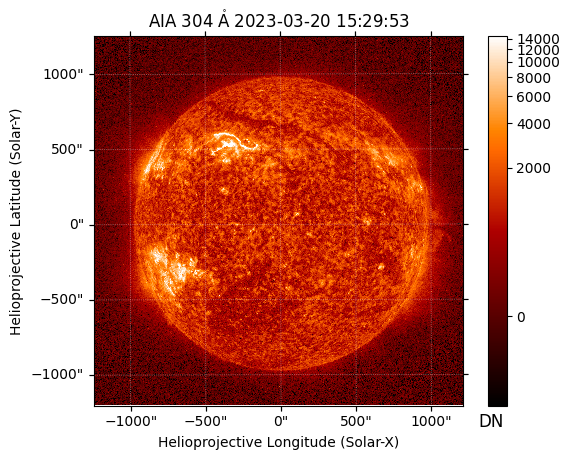

In [74]:
m_aia.peek(clip_interval=(1,99.9)*u.percent)

Let's zoom in on the part of the image where we think the flare is going off. We've manually identified this region by noting the flare "ribbons" present in our image. These features are bright in the 304 channel due to highly energetic particles impacting the cool, dense chromosphere and emitting in He II, effectively tracing out the footpoints of the structures of the flaring arcade.

We can crop to this region by specifying our bounding box in terms of the physical or *world* coordinates in the coordinate frame of this particular image.

In [76]:
blc = SkyCoord(Tx=-550*u.arcsec, Ty=300*u.arcsec, frame=m_aia.coordinate_frame)
width = 500*u.arcsec
height = 400*u.arcsec
m_aia_zoom = m_aia.submap(blc, width=width, height=height)

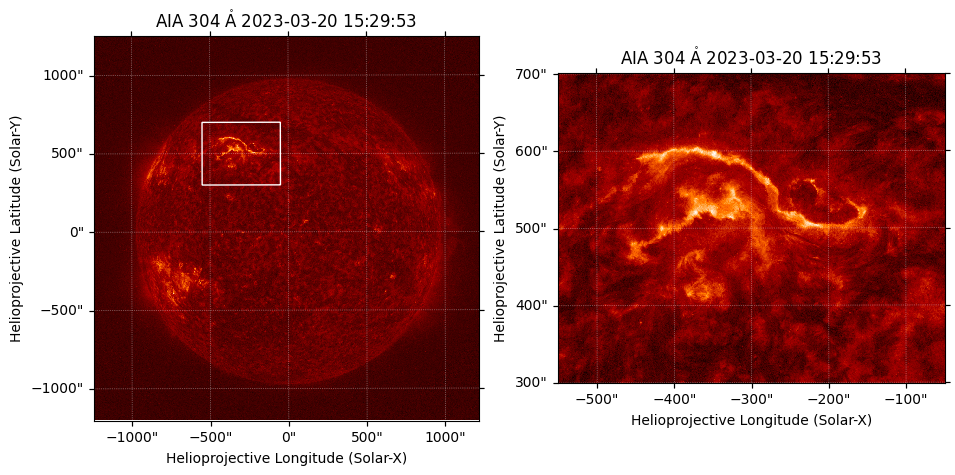

In [77]:
plt.figure(figsize=(11,5))
plt.subplot(121,projection=m_aia)
m_aia.plot()
m_aia.draw_quadrangle(blc, width=width, height=height)
plt.subplot(122,projection=m_aia_zoom)
m_aia_zoom.plot()

Now, let's load all of the images from the 174 and 304 channel of EUI, the extreme ultraviolet imager on *Solar Orbter*, into two `MapSequence` objects.

In [78]:
m_eui_174 = sunpy.map.Map(DATA_DIR / 'data/EUI/solo_L2_eui-fsi174-image_*.fits')
m_eui_304 = sunpy.map.Map(DATA_DIR / 'data/EUI/solo_L2_eui-fsi304-image_*.fits')

By using a "glob" pattern, we can load many FITS file into a list of maps. Let's take a look at just one of these.

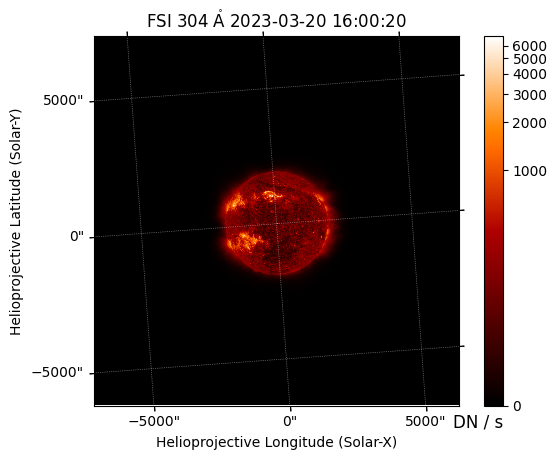

In [79]:
m_eui_304[18].peek()

Note that the same two-ribbon structure is visible on the disk as expected given the relative perspectives of the two spacecraft.

The field of view of the EUI Full Sun Imager (FSI) on *Solar Orbiter* is very wide. Let's crop our list of maps to the same field of view as our AIA images. Fortunately, we can reuse the bounding box for the flaring region we identifed above by using the coordinates of the bottom left and top right corners of our AIA map.

In [80]:
roi_blc = m_aia_zoom.bottom_left_coord
roi_trc = m_aia_zoom.top_right_coord

Additionally, because the length of our observing interval is 6 hours and the desired field of view is relatively small, we need to account for the rotation of the Sun relative to the position of our spacecraft. Otherwise, the feature of interest would rotate out of view. Fortunately, `sunpy` makes this relatively easy. through the [`propagate_with_solar_surface`](https://docs.sunpy.org/en/stable/generated/api/sunpy.coordinates.propagate_with_solar_surface.html) *context manager*. This allows us to account for the effect of differential rotation of the Sun when transforming between coordinate frames defined at different times.

In [81]:
from sunpy.coordinates import propagate_with_solar_surface

In [82]:
with propagate_with_solar_surface():
    m_eui_304_zoom = []
    for m in m_eui_304:
        blc = roi_blc.transform_to(m.coordinate_frame)
        trc = roi_trc.transform_to(m.coordinate_frame)
        m_eui_304_zoom.append(m.submap(blc, top_right=trc))

In [83]:
m_eui_304_zoom = sunpy.map.Map(m_eui_304_zoom, sequence=True)

Let's apply this same procedure to the 174 maps as well. This time, we'll reduce the amount of code to do this by using a list comprehension and combining a few steps. The result will be the same as above though.

In [84]:
with propagate_with_solar_surface():
    m_eui_174_zoom = sunpy.map.Map(
        [m.submap(roi_blc.transform_to(m.coordinate_frame), top_right=roi_trc.transform_to(m.coordinate_frame)) for m in m_eui_174],
        sequence=True,
    )

Finally, let's make an animation of the flaring region as observed by EUI in the 304 and 174 channels.

2025-02-18 14:17:44 - matplotlib.animation - INFO: Animation.save using <class 'matplotlib.animation.HTMLWriter'>


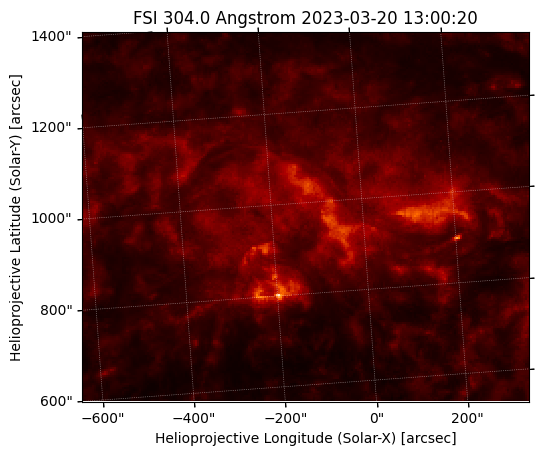

In [88]:
ani_eui_304 = m_eui_304_zoom.plot(norm=ImageNormalize(vmin=0, vmax=5e3, stretch=AsinhStretch()))
HTML(ani_eui_304.to_jshtml())

Notice that in the case of the 174 channel, the flare ribbons are much less prominent, while the post-flare arcade is much more visible. This is because this channel is much more sensitive to plasma around a 1 MK that fills the loops in the arcade during the later stage of the flare.

2025-02-18 14:17:47 - matplotlib.animation - INFO: Animation.save using <class 'matplotlib.animation.HTMLWriter'>


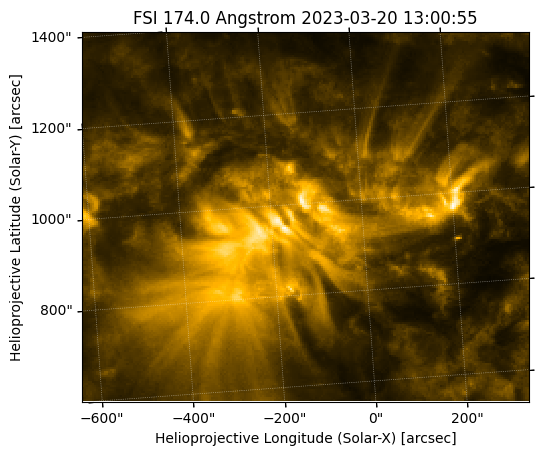

In [89]:
ani_eui_174 = m_eui_174_zoom.plot(norm=ImageNormalize(vmin=0,vmax=8e3,stretch=AsinhStretch()))
HTML(ani_eui_174.to_jshtml())

### Cross-correlating *Solar Orbiter* Data

But does the emission within our selected region correspond to the event we are interested in? To answer this, we can examine the *correlation* between the emission in 174 and 304 channels of EUI and the HXR emission from STIX that we've already confirmed corresponds to our event.

To do this, we'll use our stack of images in time that correspond to the flaring region to create a `TimeSeries` of all of our *Solar Orbiter* observations. We'll first average over the spatial extent of each 304 and 174 image and subtract an estimated background.

In [90]:
time_eui_304 = astropy.time.Time([m.date for m in m_eui_304_zoom])
ts_eui_304 = u.Quantity([m.data.mean() for m in m_eui_304_zoom], m_eui_304_zoom[0].unit)
ts_eui_304 -= ts_eui_304.min()
time_eui_174 = astropy.time.Time([m.date for m in m_eui_174_zoom])
ts_eui_174 = u.Quantity([m.data.mean() for m in m_eui_174_zoom], m_eui_174_zoom[0].unit)
ts_eui_174 -= ts_eui_174.min()

We'll also background subtract our STIX lightcurve and normalize by the exposure time.

In [91]:
ts_stix_410 = ts_stix_flare.quantity('4-10 keV') / (ts_stix_flare.meta.metas[0]['xposure'] * u.s)
ts_stix_410 -= ts_stix_410[0]

Next, we'll interpolate each to a common time axis.

In [92]:
t_common = np.arange(0, 6, (10*u.minute).to_value('h')) * u.h

In [93]:
def interp_intensities(time_common, time, time_0, intensity):
    time_norm = (time - time_0).to_value('s')
    return np.interp(time_common.to_value('s'), time_norm, intensity.value) * intensity.unit

We can then use a `pandas` to easily build our `TimeSeries` object from our `dict` of columns.

In [94]:
import pandas

In [96]:
columns = {}
columns['time'] = (time_eui_174[0] + t_common).datetime
for time, intensity, name in [(time_eui_174, ts_eui_174, r'EUI 174 $\mathrm{\AA}$'),
                              (time_eui_304, ts_eui_304, r'EUI 304 $\mathrm{\AA}$'),
                              (ts_stix_flare.time, ts_stix_410, 'STIX 4-10 keV')]:
    columns[name] = interp_intensities(t_common, time, time_eui_174[0], intensity)
ts_solo = sunpy.timeseries.TimeSeries(pandas.DataFrame.from_dict(columns).set_index('time'))

We can then visualize this dataset in the same we did with our XRS and STIX data.

<Axes: xlabel='time'>

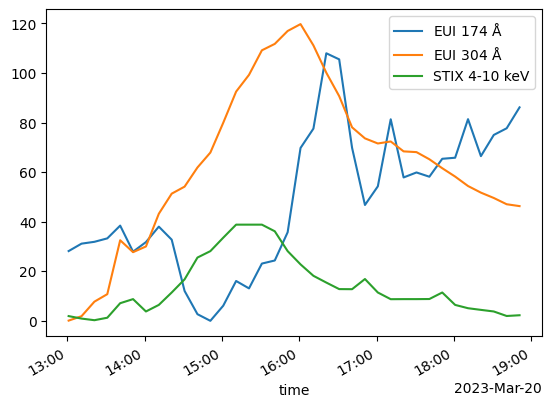

In [97]:
ts_solo.plot()

The `sunkit-image` package, another SunPy-affiliated package, includes functionality for computing cross-correlations for any data array that includes a time dimension. We can use this functionality to compute cross-correlation curves between pairs of our intensity curves from above.

In [98]:
from sunkit_image.time_lag import get_lags, cross_correlation

We'll compute these cross-correlations as a function of the offset in time between each curve or the *time lag* between each curve.

In [99]:
lags = get_lags(t_common)

In [100]:
cc_stix_304 = cross_correlation(ts_solo.quantity('STIX 4-10 keV'), ts_solo.quantity(r'EUI 304 $\mathrm{\AA}$'), lags,)
cc_stix_174 = cross_correlation(ts_solo.quantity('STIX 4-10 keV'), ts_solo.quantity(r'EUI 174 $\mathrm{\AA}$'), lags,)
cc_304_174 = cross_correlation(ts_solo.quantity(r'EUI 304 $\mathrm{\AA}$'), ts_solo.quantity(r'EUI 174 $\mathrm{\AA}$'), lags,)

All three pairs are reasonably well correlated. There is a positive delay between the STIX intensity and the 304 EUI intensity as the footpoint brightenings follow the emission of x-rays from the flare. Additionally, the post-flare loops brighten later in the 174 EUI channel as the plasma cools down to 1 MK, explaining the longer delay between STIX and EUI 174 as well as EUI 304 and 174.

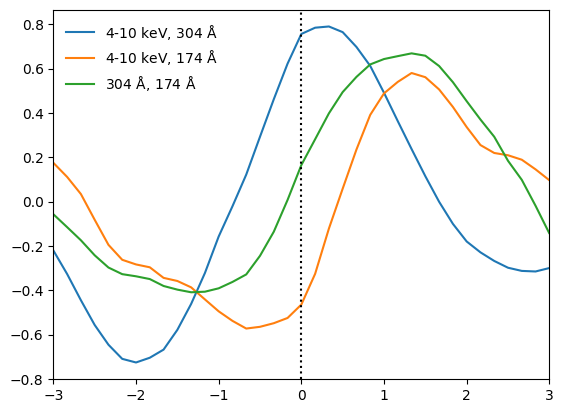

In [101]:
plt.plot(lags, cc_stix_304, label=r'4-10 keV, 304 $\mathrm{\AA}$')
plt.plot(lags, cc_stix_174, label=r'4-10 keV, 174 $\mathrm{\AA}$')
plt.plot(lags, cc_304_174, label=r'304 $\mathrm{\AA}$, 174 $\mathrm{\AA}$')
plt.axvline(x=0, color='k', ls=':')
plt.xlim(-3,3)
plt.legend(frameon=False)

We've quantitatively shown that emission in our limited EUI field of view corresponds to the flare observed by STIX.

## What was happening in the solar wind?

Finally, let's look out into the solar wind to see both the corresponding *in situ* data as well as an alternate view of the CME that was launched as a result of this flare.

### *in situ*

In addition to search many common sources of remote sensing data, `Fido` can also search the [NASA Coordinated Data Analysis Web (CDAWeb)](https://cdaweb.gsfc.nasa.gov/) which provides a portal for most *in situ* heliospheric data. We'll be searching CDAWeb for data from both *Parker Solar Probe* as well as *Solar Orbiter*.

To make sure our search interval includes the relavant times, we'll extend our time interval to approximately the time when the CME would have arrived at Earth.

In [102]:
q_psp_solo = Fido.search(
    a.Time(time_event_start, time_event_end+4*u.day),
    a.cdaweb.Dataset('PSP_FLD_L2_MAG_RTN_1MIN') | a.cdaweb.Dataset('SOLO_L2_MAG-RTN-NORMAL-1-MINUTE')
)

In [103]:
q_psp_solo

Dataset,Start time,End time,URL
str23,str23,str23,str114
PSP_FLD_L2_MAG_RTN_1MIN,2023-03-20 00:00:30.000,2023-03-20 23:59:30.000,https://cdaweb.gsfc.nasa.gov/sp_phys/data/psp/fields/l2/mag_rtn_1min/2023/psp_fld_l2_mag_rtn_1min_20230320_v02.cdf
PSP_FLD_L2_MAG_RTN_1MIN,2023-03-21 00:00:30.000,2023-03-21 23:59:30.000,https://cdaweb.gsfc.nasa.gov/sp_phys/data/psp/fields/l2/mag_rtn_1min/2023/psp_fld_l2_mag_rtn_1min_20230321_v02.cdf
PSP_FLD_L2_MAG_RTN_1MIN,2023-03-22 00:00:30.000,2023-03-22 23:59:30.000,https://cdaweb.gsfc.nasa.gov/sp_phys/data/psp/fields/l2/mag_rtn_1min/2023/psp_fld_l2_mag_rtn_1min_20230322_v02.cdf
PSP_FLD_L2_MAG_RTN_1MIN,2023-03-23 00:00:30.000,2023-03-23 23:59:30.000,https://cdaweb.gsfc.nasa.gov/sp_phys/data/psp/fields/l2/mag_rtn_1min/2023/psp_fld_l2_mag_rtn_1min_20230323_v02.cdf
PSP_FLD_L2_MAG_RTN_1MIN,2023-03-24 00:00:30.000,2023-03-24 23:59:30.000,https://cdaweb.gsfc.nasa.gov/sp_phys/data/psp/fields/l2/mag_rtn_1min/2023/psp_fld_l2_mag_rtn_1min_20230324_v02.cdf
Dataset,Start time,End time,URL
str31,str23,str23,str144
SOLO_L2_MAG-RTN-NORMAL-1-MINUTE,2023-03-20 00:00:29.000,2023-03-20 23:59:30.000,https://cdaweb.gsfc.nasa.gov/sp_phys/data/solar-orbiter/mag/science/l2/rtn-normal-1-minute/2023/solo_l2_mag-rtn-normal-1-minute_20230320_v01.cdf
SOLO_L2_MAG-RTN-NORMAL-1-MINUTE,2023-03-21 00:00:29.000,2023-03-21 23:59:30.000,https://cdaweb.gsfc.nasa.gov/sp_phys/data/solar-orbiter/mag/science/l2/rtn-normal-1-minute/2023/solo_l2_mag-rtn-normal-1-minute_20230321_v01.cdf


In [104]:
!mkdir -p data/in_situ

In [105]:
files_psp_solo = Fido.fetch(q_psp_solo, path='data/in_situ', max_conn=1)

Files Downloaded:   0%|          | 0/8 [00:00<?, ?file/s]

As before, we'll create our `TimeSeries` objects by passing in paths to our data.

In [106]:
ts_psp = sunpy.timeseries.TimeSeries(DATA_DIR / 'data/in_situ/psp_fld_*.cdf', concatenate=True)

Interestingly, the PSP magnetometer data does not seem to have observed much in the way of this event. This is likely due to the position of the spacecraft relative to the direction of propagation of the event.

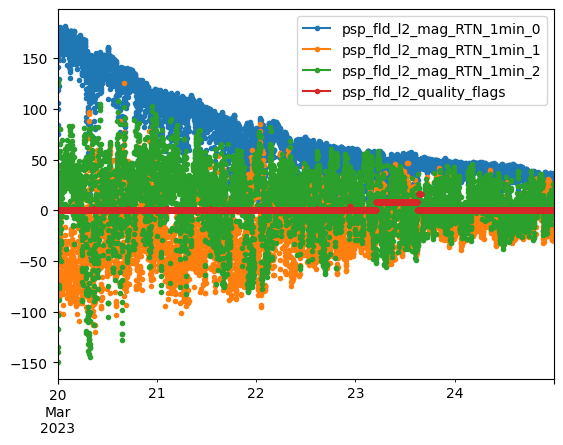

In [107]:
ts_psp.peek(marker='.')

In [108]:
ts_solo_insitu = sunpy.timeseries.TimeSeries(DATA_DIR / 'data/in_situ/solo_l2_mag-*.cdf', concatenate=True)

In [109]:
cme_speed = 1000*u.km / u.s

In [110]:
time_propagation_solo = (solo_loc.radius - (1*u.R_sun)) / cme_speed

In contrast, the magnetometer data on *Solar Orbiter* shows a clear disturbance in all three magnetic field components at the approximate time at which we would expect the CME to arrive at the spacecraft. This is due to *Solar Orbiter* being more directly in the path of the CME. We can see that the disturbance in the field begins approximately when we'd expect the CME to arrive.

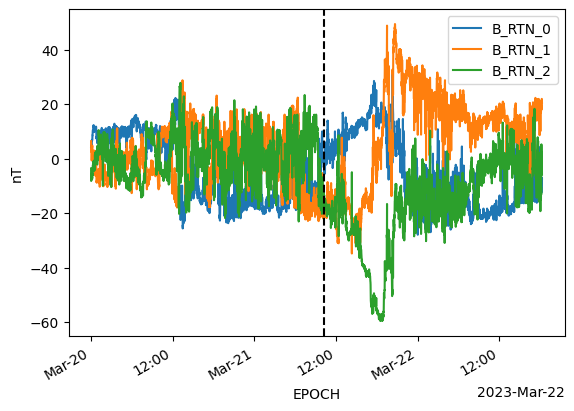

In [111]:
ts_solo_insitu.plot(columns=['B_RTN_0', 'B_RTN_1', 'B_RTN_2'])
plt.axvline((time_event_start+time_propagation_solo).datetime, color='k', ls='--')

### Images

Finally, let's take a look back at PSP data, but this time looking at the image data from the Wide Field Imager for Parker Solar Probe (WISPR). WISPR is unique in that it looks to the side relative to the direction PSP is pointing in order to image structures in the solar wind.

We'll again use `Fido` to search for WISPR data, slightly lengthening our time window to account for propagation to PSP.

In [112]:
q_wispr = Fido.search(a.Time(time_event_start, end=time_event_end+10*u.h),
                      a.Instrument.wispr,
                      a.Level(3))

In [113]:
q_wispr

Start Time,End Time,Source,Instrument,Wavelength,Provider,Physobs,Wavetype,Extent X,Extent Y,Extent Width,Extent Length,Extent Type,Size
,,,,Angstrom,,,,,,,,,Mibyte
Time,Time,str3,str5,float64[2],str3,str9,str7,str10,str10,str10,str10,str11,float64
2023-03-20 13:00:22.000,2023-03-20 13:00:57.000,PSP,WISPR,4900.0 .. 7400.0,NRL,intensity,visible,32.5294486,-3.3538845,40.6128000,43.3203200,FAR_OFF_SUN,3.77148
2023-03-20 13:02:10.000,2023-03-20 13:05:28.000,PSP,WISPR,4750.0 .. 7250.0,NRL,intensity,visible,76.9446924,-5.7614671,54.2161920,57.8306048,FAR_OFF_SUN,3.77148
2023-03-20 13:08:08.000,2023-03-20 13:08:44.000,PSP,WISPR,4900.0 .. 7400.0,NRL,intensity,visible,32.5290460,-3.3547098,40.6128000,43.3203200,FAR_OFF_SUN,3.77148
2023-03-20 13:09:34.000,2023-03-20 13:12:52.000,PSP,WISPR,4750.0 .. 7250.0,NRL,intensity,visible,76.9447869,-5.7611674,54.2161920,57.8306048,FAR_OFF_SUN,3.77148
2023-03-20 13:15:33.000,2023-03-20 13:16:08.000,PSP,WISPR,4900.0 .. 7400.0,NRL,intensity,visible,32.5291863,-3.3550807,40.6128000,43.3203200,FAR_OFF_SUN,3.77148
2023-03-20 13:17:06.000,2023-03-20 13:20:24.000,PSP,WISPR,4750.0 .. 7250.0,NRL,intensity,visible,76.9453424,-5.7591195,54.2161920,57.8306048,FAR_OFF_SUN,3.77148
2023-03-20 13:23:04.000,2023-03-20 13:23:40.000,PSP,WISPR,4900.0 .. 7400.0,NRL,intensity,visible,32.5288751,-3.3556839,40.6128000,43.3203200,FAR_OFF_SUN,3.77148
2023-03-20 13:24:38.000,2023-03-20 13:27:56.000,PSP,WISPR,4750.0 .. 7250.0,NRL,intensity,visible,76.9446220,-5.7602648,54.2161920,57.8306048,FAR_OFF_SUN,3.77148


There are a lot of observations in this window so we'll only take 20% of them.

In [114]:
files_wispr = Fido.fetch(q_wispr[0][::5], path="data/{instrument}/{file}")

Files Downloaded:   0%|          | 0/52 [00:00<?, ?file/s]

We'll create two sets of `MapSequence`s, one for the inner and outer imager (denoted by the numbers appended to the filenames).

In [116]:
m_wispr_outer = sunpy.map.Map(DATA_DIR / 'data/WISPR/*_2222.fits')
m_wispr_inner = sunpy.map.Map(DATA_DIR / 'data/WISPR/*_1221.fits')

Let's visualize the two images at one time step.

In [117]:
wispr_norm = ImageNormalize(vmin=0, vmax=0.5e-11, stretch=PowerStretch(1/2.2))

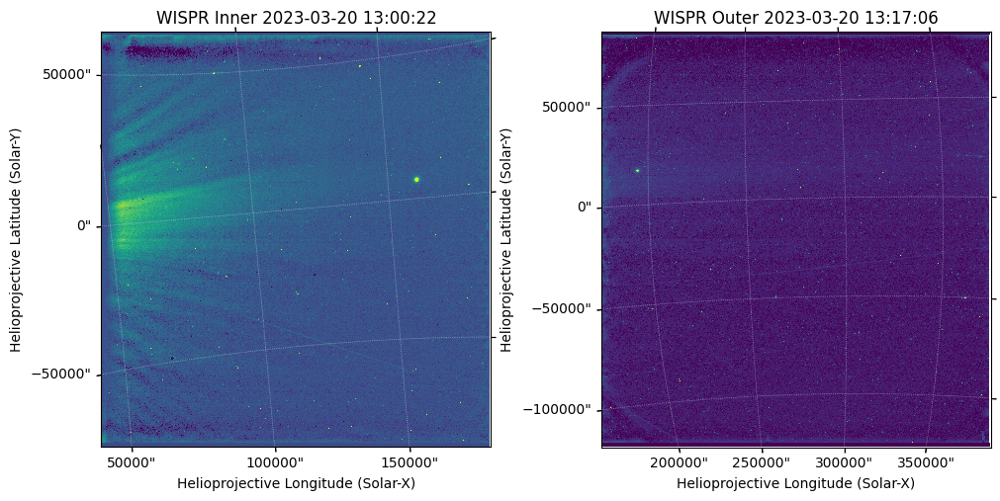

In [118]:
plt.figure(figsize=(10,5),layout='constrained')
plt.subplot(121, projection=m_wispr_inner[0])
m_wispr_inner[0].plot(norm=wispr_norm, cmap="viridis")
plt.subplot(122, projection=m_wispr_outer[0])
m_wispr_outer[0].plot(norm=wispr_norm, cmap="viridis")

Instead what we'd like to do is visualize data from these two cameras *together*. Fortunately, `sunpy` provides some really convenient machinery for reprojecting images into different coordinate frames. The following function takes an inner and outer WISPR image and combines them by reprojecting them to a common coordinate system. There are a lot of details in how this process works. **We do not need to worry about those at this point.**

In [121]:
from sunpy.coordinates.frames import Helioprojective
import astropy.wcs

def combine_wispr_maps(inner_map, outer_map):
    ref_coord = SkyCoord(0*u.arcsec, 0*u.arcsec,
                         frame=Helioprojective(observer=inner_map.observer_coordinate, obstime=inner_map.date))
    outshape = (360*2, int(360*3.5))
    new_header = sunpy.map.make_fitswcs_header(
        outshape,
        ref_coord,
        reference_pixel=u.Quantity([40*u.pixel, 500*u.pixel]),
        scale=u.Quantity([0.1*u.deg/u.pixel, 0.1*u.deg/u.pixel]),
        projection_code="CAR",
    )
    out_wcs = astropy.wcs.WCS(new_header)
    with Helioprojective.assume_spherical_screen(inner_map.observer_coordinate):
        array, footprint = reproject_and_coadd((inner_map, outer_map), out_wcs, outshape,
                                               reproject_function=reproject_interp, match_background=True)
    combined_map = sunpy.map.Map((array, new_header))
    combined_map.plot_settings["norm"] = wispr_norm
    combined_map.plot_settings["cmap"] = "viridis"
    return combined_map

Let's apply this combination procedure at one time step and visualize the resulting map with the position of the solar disk overlaid.

In [122]:
m_wispr_combined = combine_wispr_maps(m_wispr_inner[7], m_wispr_outer[7])

2025-02-18 14:19:14 - reproject.mosaicking.coadd - INFO: Output mosaic will have shape (720, 1260)
2025-02-18 14:19:14 - reproject.mosaicking.coadd - INFO: Not using on-the-fly mode for adding individual reprojected images to output array
2025-02-18 14:19:14 - reproject.mosaicking.coadd - INFO: Processing input data 1 of 2
2025-02-18 14:19:14 - reproject.mosaicking.coadd - INFO: Calling reproject_interp with shape_out=(416, 408)
2025-02-18 14:19:14 - reproject.common - INFO: Calling _reproject_full in non-dask mode
2025-02-18 14:19:14 - reproject.mosaicking.coadd - INFO: Adding reprojected array to list to combine later
2025-02-18 14:19:14 - reproject.mosaicking.coadd - INFO: Processing input data 2 of 2
2025-02-18 14:19:14 - reproject.mosaicking.coadd - INFO: Calling reproject_interp with shape_out=(575, 665)
2025-02-18 14:19:14 - reproject.common - INFO: Calling _reproject_full in non-dask mode
2025-02-18 14:19:14 - reproject.mosaicking.coadd - INFO: Adding reprojected array to list 

(<matplotlib.patches.Circle at 0x475162c10>, None)

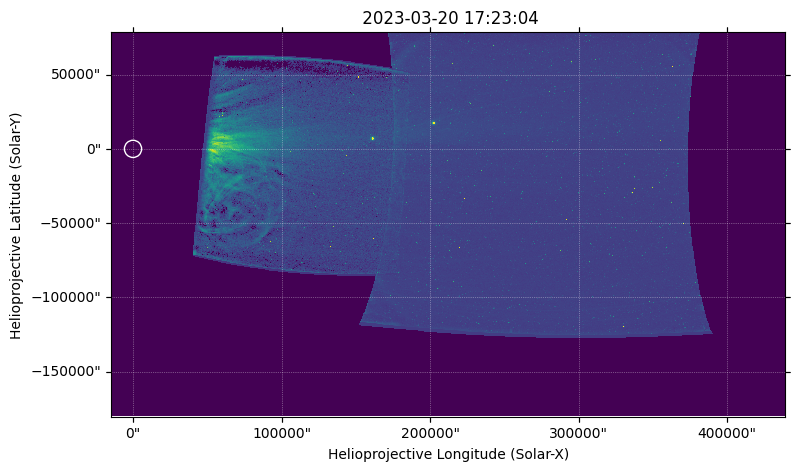

In [123]:
plt.figure(figsize=(10, 5))
m_wispr_combined.plot()
m_wispr_combined.draw_limb(color='w')

Now, let's combine the sets of images at every time step to visualize the propoagation of the CME through both cameras.

In [124]:
m_wispr_combined = sunpy.map.Map([combine_wispr_maps(m_i, m_o) for m_i,m_o in zip(m_wispr_inner,m_wispr_outer)], sequence=True)

2025-02-18 14:19:17 - reproject.mosaicking.coadd - INFO: Output mosaic will have shape (720, 1260)
2025-02-18 14:19:17 - reproject.mosaicking.coadd - INFO: Not using on-the-fly mode for adding individual reprojected images to output array
2025-02-18 14:19:17 - reproject.mosaicking.coadd - INFO: Processing input data 1 of 2
2025-02-18 14:19:17 - reproject.mosaicking.coadd - INFO: Calling reproject_interp with shape_out=(416, 408)
2025-02-18 14:19:17 - reproject.common - INFO: Calling _reproject_full in non-dask mode
2025-02-18 14:19:17 - reproject.mosaicking.coadd - INFO: Adding reprojected array to list to combine later
2025-02-18 14:19:17 - reproject.mosaicking.coadd - INFO: Processing input data 2 of 2
2025-02-18 14:19:17 - reproject.mosaicking.coadd - INFO: Calling reproject_interp with shape_out=(575, 665)
2025-02-18 14:19:17 - reproject.common - INFO: Calling _reproject_full in non-dask mode
2025-02-18 14:19:17 - reproject.mosaicking.coadd - INFO: Adding reprojected array to list 

Finally, as with the LASCO images, we can compute a running difference movie to draw out the structure.

In [125]:
m_wispr_running = sunpy.map.Map(
    [m - prev_m.quantity for m, prev_m in zip(m_wispr_combined[1:], m_wispr_combined[:-1])],
    sequence=True
)

(<matplotlib.patches.Circle at 0x37fe77890>, None)

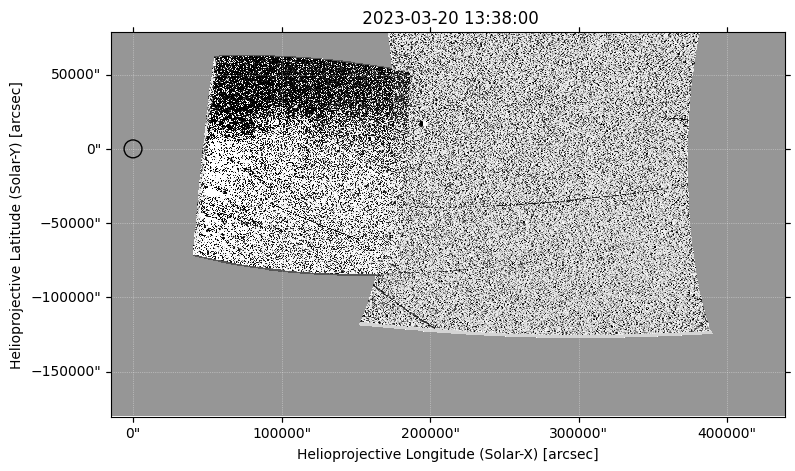

In [126]:
plt.figure(figsize=(10, 5))
ani_wispr = m_wispr_running.plot(norm=SymLogNorm(1e-14,vmin=-1e-13,vmax=1e-13), cmap='Greys_r')
m_wispr_running[0].draw_limb(color='k')

In [127]:
HTML(ani_wispr.to_jshtml())

2025-02-18 14:19:26 - matplotlib.animation - INFO: Animation.save using <class 'matplotlib.animation.HTMLWriter'>


## Conclusion

To conclude, in this notebook we showed how to use `sunpy` and its affiliated packages, to analyze a flare and subsequent CME as it is initiated on the solar disk and propagates into the solar wind.
In the process, we learned how to:

- Combine data from different observatories with `reproject`
- Search for and download *in situ* and remote sensing data with `sunpy`
- Create, manipulate and visualize `sunpy.timeseries.TimeSeries` objects
- Create movies from sequences of `sunpy.map.Map` objects